In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python

import io # Input/Output Module
import os # OS interfaces
import cv2 # OpenCV package
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

from urllib import request # module for opening HTTP requests
from matplotlib import pyplot as plt # Plotting library
!pip install scikit-image

<div style="width:100%; height:140px">
    <img src="https://www.kuleuven.be/internationaal/thinktank/fotos-en-logos/ku-leuven-logo.png/image_preview" width = 300px, heigh = auto align=left>
</div>


KUL H02A5a Computer Vision: Group Assignment 1
---------------------------------------------------------------
Student numbers: <span style="color:red">r0653717, r0736565, r0575991, r0829669, r0776192</span>.

The goal of this assignment is to explore more advanced techniques for constructing features that better describe objects of interest and to perform face recognition using these features. This assignment will be delivered in groups of 5 (either composed by you or randomly assigned by your TA's).

In this assignment you are a group of computer vision experts that have been invited to ECCV 2021 to do a tutorial about  "Feature representations, then and now". To prepare the tutorial you are asked to participate in a kaggle competition and to release a notebook that can be easily studied by the tutorial participants. Your target audience is: (master) students who want to get a first hands-on introduction to the techniques that you apply.

---------------------------------------------------------------
This notebook is structured as follows:
0. Data loading & Preprocessing
1. Feature Representations
2. Evaluation Metrics 
3. Classifiers
4. Experiments
5. Publishing best results
6. Discussion

Make sure that your notebook is **self-contained** and **fully documented**. Walk us through all steps of your code. Treat your notebook as a tutorial for students who need to get a first hands-on introduction to the techniques that you apply. Provide strong arguments for the design choices that you made and what insights you got from your experiments. Make use of the *Group assignment* forum/discussion board on Toledo if you have any questions.

Fill in your student numbers above and get to it! Good luck! 


<div class="alert alert-block alert-info">
<b>NOTE:</b> This notebook is just a example/template, feel free to adjust in any way you please! Just keep things organised and document accordingly!
</div>

<div class="alert alert-block alert-info">
<b>NOTE:</b> Clearly indicate the improvements that you make!!! You can for instance use titles like: <i>3.1. Improvement: Non-linear SVM with RBF Kernel.<i>
</div>
    
---------------------------------------------------------------
# 0. Data loading & Preprocessing

## 0.1. Loading data
The training set is many times smaller than the test set and this might strike you as odd, however, this is close to a real world scenario where your system might be put through daily use! In this session we will try to do the best we can with the data that we've got! 

In [2]:
# Input data files are available in the read-only "../input/" directory

train = pd.read_csv(
    'data/train_set.csv', index_col = 0)
    #'/kaggle/input/kul-h02a5a-computervision-groupassignment0/train_set.csv', index_col = 0)
train.index = train.index.rename('id')

test = pd.read_csv(
    'data/test_set.csv', index_col = 0)
    #'/kaggle/input/kul-h02a5a-computervision-groupassignment0/test_set.csv', index_col = 0)
test.index = test.index.rename('id')

# read the images as numpy arrays and store in "img" column
train['img'] = [cv2.cvtColor(np.load('data/train/train/train_{}.npy'.format(index), allow_pickle=False), cv2.COLOR_BGR2RGB) #[cv2.cvtColor(np.load('/kaggle/input/kul-h02a5a-computervision-groupassignment0/train/train/train_{}.npy'.format(index), allow_pickle=False), cv2.COLOR_BGR2RGB) 
                for index, row in train.iterrows()]

test['img'] = [cv2.cvtColor(np.load('data/test/test/test_{}.npy'.format(index), allow_pickle=False), cv2.COLOR_BGR2RGB) # [cv2.cvtColor(np.load('/kaggle/input/kul-h02a5a-computervision-groupassignment0/test/test/test_{}.npy'.format(index), allow_pickle=False), cv2.COLOR_BGR2RGB) 
                for index, row in test.iterrows()]
  

train_size, test_size = len(train),len(test)

"The training set contains {} examples, the test set contains {} examples.".format(train_size, test_size)

'The training set contains 80 examples, the test set contains 1816 examples.'

*Note: this dataset is a subset of the* [*VGG face dataset*](https://www.robots.ox.ac.uk/~vgg/data/vgg_face/).

## 0.2. A first look
Let's have a look at the data columns and class distribution.

In [3]:
# The training set contains an identifier, name, image information and class label
train.head(1)

,name,class,img
id,,,
0,Mila_Kunis,2,"[[[50, 31, 25], [49, 30, 24], [49, 30, 24], [4..."


In [4]:
# The test set only contains an identifier and corresponding image information.

test.head(1)

,img
id,
0,"[[[209, 210, 205], [208, 209, 204], [208, 209,..."


In [5]:
# The class distribution in the training set:
train.groupby('name').agg({'img':'count', 'class': 'max'})

,img,class
name,,
Jesse_Eisenberg,30,1
Michael_Cera,10,0
Mila_Kunis,30,2
Sarah_Hyland,10,0


Note that **Jesse is assigned the classification label 1**, and **Mila is assigned the classification label 2**. The dataset also contains 20 images of **look alikes (assigned classification label 0)** and the raw images. 

## 0.3. Preprocess data
### 0.3.1 Example: HAAR face detector
In this example we use the [HAAR feature based cascade classifiers](https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_objdetect/py_face_detection/py_face_detection.html) to detect faces, then the faces are resized so that they all have the same shape. If there are multiple faces in an image, we only take the first one. 

<div class="alert alert-block alert-info"> <b>NOTE:</b> You can write temporary files to <code>/kaggle/temp/</code> or <code>../../tmp</code>, but they won't be saved outside of the current session
</div>


In [6]:
class HAARPreprocessor():
    """Preprocessing pipeline built around HAAR feature based cascade classifiers. """
    
    def __init__(self, path, face_size):
        self.face_size = face_size
        file_path = os.path.join(path, "haarcascade_frontalface_default.xml")
        if not os.path.exists(file_path): 
            if not os.path.exists(path):
                os.mkdir(path)
            self.download_model(file_path)
        
        self.classifier = cv2.CascadeClassifier(file_path)
  
    def download_model(self, path):
        url = "https://raw.githubusercontent.com/opencv/opencv/master/data/"\
            "haarcascades/haarcascade_frontalface_default.xml"
        
        with request.urlopen(url) as r, open(path, 'wb') as f:
            f.write(r.read())
            
    def detect_faces(self, img):
        """Detect all faces in an image."""
        
        img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        return self.classifier.detectMultiScale(
            img_gray,
            scaleFactor=1.2,
            minNeighbors=5,
            minSize=(30, 30),
            flags=cv2.CASCADE_SCALE_IMAGE
        )
        
    def extract_faces(self, img):
        """Returns all faces (cropped) in an image."""
        
        faces = self.detect_faces(img)

        return [img[y:y+h, x:x+w] for (x, y, w, h) in faces]
    
    def preprocess(self, data_row):
        faces = self.extract_faces(data_row['img'])
        
        # if no faces were found, return None
        if len(faces) == 0:
            nan_img = np.empty(self.face_size + (3,))
            nan_img[:] = np.nan
            return nan_img
        
        # only return the first face
        return cv2.resize(faces[0], self.face_size, interpolation = cv2.INTER_AREA)
            
    def __call__(self, data):
        return np.stack([self.preprocess(row) for _, row in data.iterrows()]).astype('uint8')

**Visualise**

Let's plot a few examples.

In [7]:
# parameter to play with 
FACE_SIZE = (100, 100)

def plot_image_sequence(data, n, imgs_per_row=7, titles=None):
    n_rows = 1 + int(n/(imgs_per_row+1))
    n_cols = min(imgs_per_row, n)

    f,ax = plt.subplots(n_rows,n_cols, figsize=(10*n_cols,10*n_rows))
    cmap = 'gray' if len(data[0].shape) == 2 else None
    for i in range(n):
        if n == 1:
            if titles is not None:
                ax.set_title(titles[i])
            ax.imshow(data[i], cmap=cmap)
        elif n_rows > 1:
            if titles is not None:
                ax[int(i/imgs_per_row),int(i%imgs_per_row)].set_title(titles[i][0], size=titles[i][1], pad=titles[i][2])
            ax[int(i/imgs_per_row),int(i%imgs_per_row)].imshow(data[i], cmap=cmap)
        else:
            if titles is not None:
                ax[int(i%n)].set_title(titles[i])
            ax[int(i%n)].imshow(data[i], cmap=cmap)
    plt.show()

    
#preprocessed data 
preprocessor = HAARPreprocessor(path = '../../tmp', face_size=FACE_SIZE)

train_X, train_y = preprocessor(train), train['class'].values
test_X = preprocessor(test)



In [8]:
# get faces per class
jesse_train = train_X[train_y == 1]
mila_train = train_X[train_y == 2]
michael_sarah_train = train_X[train_y == 0]

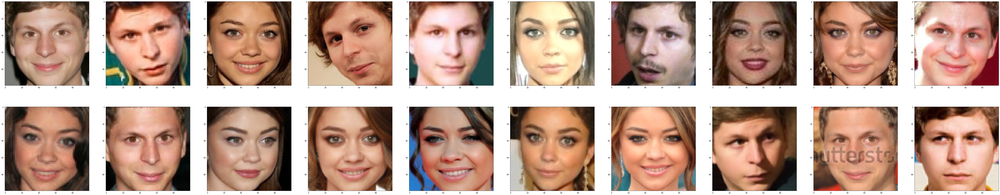

In [9]:
# plot faces of Michael and Sarah

plot_image_sequence(michael_sarah_train, n=20, imgs_per_row=10)

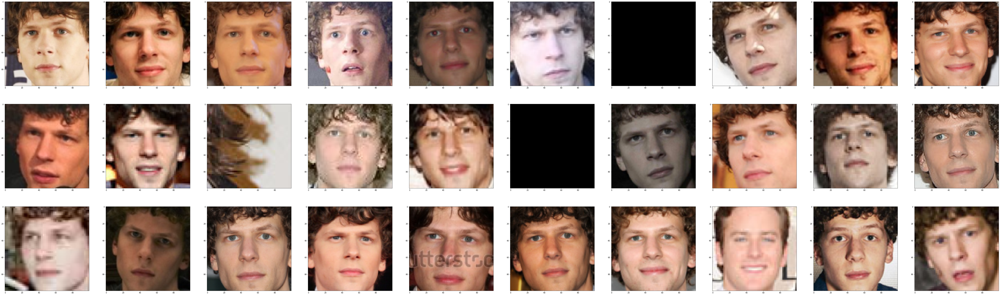

In [10]:
# plot faces of Jesse

plot_image_sequence(jesse_train, n=30, imgs_per_row=10)

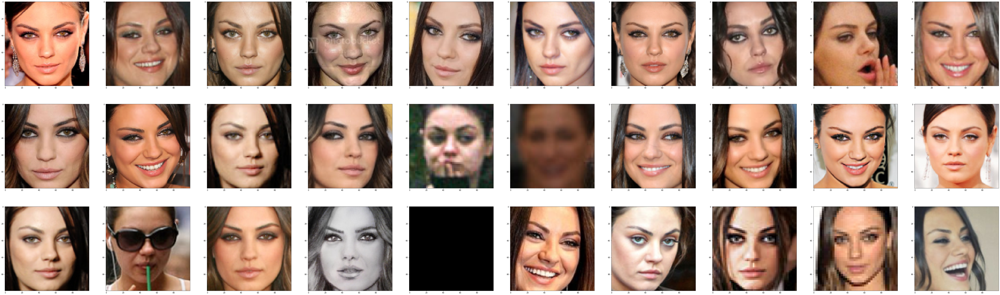

In [11]:
# plot faces of Mila

plot_image_sequence(mila_train, n=30, imgs_per_row=10)

## 0.4. Store Preprocessed data (optional)
<div class="alert alert-block alert-info">
<b>NOTE:</b> You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All". Feel free to use this to store intermediary results.
</div>

In [12]:
# save preprocessed data
# prep_path = '/kaggle/working/prepped_data/'
# if not os.path.exists(prep_path):
#     os.mkdir(prep_path)
    
# np.save(os.path.join(prep_path, 'train_X.npy'), train_X)
# np.save(os.path.join(prep_path, 'train_y.npy'), train_y)
# np.save(os.path.join(prep_path, 'test_X.npy'), test_X)

# load preprocessed data
# prep_path = '/kaggle/working/prepped_data/'
# if not os.path.exists(prep_path):
#     os.mkdir(prep_path)
# train_X = np.load(os.path.join(prep_path, 'train_X.npy'))
# train_y = np.load(os.path.join(prep_path, 'train_y.npy'))
# test_X = np.load(os.path.join(prep_path, 'test_X.npy'))

Now we are ready to rock!

# 1. Feature Representations
## 1.0. Example: Identify feature extractor
Our example feature extractor doesn't actually do anything... It just returns the input:
$$
\forall x : f(x) = x.
$$

It does make for a good placeholder and baseclass ;).

In [13]:
class IdentityFeatureExtractor:
    """A simple function that returns the input"""
    
    def transform(self, X):
        return X
    
    def __call__(self, X):
        return self.transform(X)

## 1.1. Baseline 1: HOG feature extractor/Scale Invariant Feature Transform
We decided to use Scale Invariant Feature Transform (SIFT) as a feature extractor. SIFT identifies "good" local features by:
 - Constructing a scale space so that these features are independant from scale.
 - Localizing the keypoints in the image, these are the points that are distinct enough from the rest of the image to be considered a local feature.
 - Orientation assignment, this makes SIFT invariant to rotation
 
Lastly, these keypoints are converted to descriptors that act like unique "fingerprints".
The scale- and rotation-invariance make these descriptors fit to be used in a classifier to do the actual recognition of a person.
The class that we have made for SIFT feature extraction has two methods: 
 - transform: expects a list of grayscale images, transforms them using SIFT, and returns a list of keypoints and descriptors
 - transform_train: Does the same as transform, but is designed to form the features into training data directly. This method expects on top of the image list the according labels and they amount of used keypoints (nkeypoints)

In [14]:
class SIFTFeatureExtractor():
    def __init__(self,**params):
        self.params = params
        self.sift = cv2.xfeatures2d.SIFT_create()
        
    def transform(self, X):
        kp_list = []
        des_list = []
        for img in X:
            # calculate SIFT keypoints (kp) and descriptor (des)
            kp, des = self.sift.detectAndCompute(img,None)
            kp_list.append(kp)
            des_list.append(des)
        return kp_list, des_list
        
    def transform_train(self, X, labels, nkeypoints):
        vector_size = 128*nkeypoints
        kp_list = []
        des_list = []
        training_data = np.array([])
        training_labels = np.array([])
        index = 0
        for img in X:
            # calculate SIFT keypoints (kp1) and descriptor (des1)
            kp1, des1 = self.sift.detectAndCompute(img,None)
            
            # shape data so that we can use it for training classifiers
            if des1 is None:
                index += 1
                continue
            if len(kp1) < nkeypoints:   #ensure that there are atleast 100 keypoints
                # duplicate some points if needed
                current_len = len(kp1)
                vectors_needed = nkeypoints - current_len
                repeated_vectors = des1[0:vectors_needed, :]
                # concatenate repeats onto des1
                while len(des1) < nkeypoints:
                    des1 = np.concatenate((des1, repeated_vectors), axis=0)
                # duplicate data just so we can run the model.
                des1[current_len:nkeypoints, :] = des1[0:vectors_needed, :]
            des1 = des1.astype(np.float64)
            np.random.shuffle(des1)
            des1 = des1[0:nkeypoints,:] # trim vector so all are same size
            vector_data = des1.reshape(1,vector_size) 
            list_data = vector_data.tolist()
            
            # We need to concatenate on the full list of features extracted from each image
            if len(training_data) == 0:
                training_data = np.append(training_data, vector_data)
                training_data = training_data.reshape(1,vector_size)
            else:
                training_data   = np.concatenate((training_data, vector_data), axis=0)
                
            training_labels = np.append(training_labels,labels[index])
            
            kp_list.append(kp1)
            index += 1
        return kp_list, training_data, training_labels


def array2gray(X):
    img_list_gray = []
    return [cv2.cvtColor(img, cv2.COLOR_RGB2GRAY) for img in X]

In order to use make use of the class above, we first need to convert the color image list into a grayscale one as this is a requirement for SIFT to work. The method array2gray takes care of that.
Now that we have a grayscale version of our training dataset we can apply the SIFTFeatureExtractor class on it by constructing an object of that class and invoke its transform_train method.

In [15]:
nkeypoints = 100
train_gray = array2gray(train_X)
feature_extractor = SIFTFeatureExtractor()
kp_list, training_data, training_labels = feature_extractor.transform_train(train_gray, train_y, nkeypoints)

To make sure if everything went well, we can now use the drawKeypoints method of the OpenCV library to visualize the keypoints. This will draw the found keypoints onto the image. 

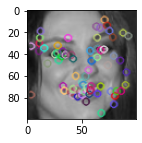

In [16]:
index = 1
vis = cv2.drawKeypoints(train_gray[index],kp_list[index],train_gray[index])
f,ax = plt.subplots(1,1, figsize=(2,2))
ax.imshow(vis)

The flag that has been passed in this example causes this method to draw the keypoints in more detail. Instead of just drawing the location of the keypoint, it will now also draw the size and orientation of the keypoint.

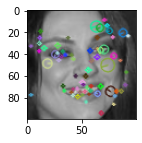

In [17]:
vis = cv2.drawKeypoints(train_gray[index],kp_list[index],train_gray[index], flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
f,ax = plt.subplots(1,1, figsize=(2,2))
ax.imshow(vis)

To illustrate the power of SIFT features, we will now use a brute force-matcher. With this, we can look for matching keypoints between 2 different images to find the object in question.
The first thing we do calculate a SIFT for both images. Next, we apply the brute-force matcher on the descriptors of both images. The resulting matches are then filtered on distance, matches above a certain distance from eachother are discarded. The remainder of the matches are drawn between the two images.

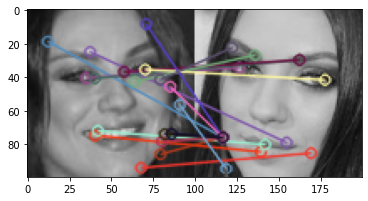

(<matplotlib.image.AxesImage at 0x7f575efbf790>, None)

In [18]:
index2 = 8

sift = cv2.xfeatures2d.SIFT_create()
kp1, des1 = sift.detectAndCompute(train_gray[index],None)
kp2, des2 = sift.detectAndCompute(train_gray[index2],None)

# create BFMatcher object
bf = cv2.BFMatcher()

# Match descriptors.
matches = bf.knnMatch(des1,des2,k=2)

# Apply ratio test
good = []
for m,n in matches:
    if m.distance < 0.85*n.distance:
        good.append([m])

match_img = cv2.drawMatchesKnn(train_gray[index],kp1,train_gray[index2],kp2,good,None,flags=2)

plt.imshow(match_img),plt.show()


Note how the eyes are correctly matched, but there are several bad keypoints that do not give good matches between the images. These are mostly situated at the edges of the face and hair-line.

### 1.1.1. t-SNE Plots
t-Distributed Stochastic Neighbor Embedding is a technique that is used the visualization of high-dimensional datasets.

[t-SNE] Computing 76 nearest neighbors...
[t-SNE] Indexed 77 samples in 0.001s...
[t-SNE] Computed neighbors for 77 samples in 0.007s...
[t-SNE] Computed conditional probabilities for sample 77 / 77
[t-SNE] Mean sigma: 627.138292
[t-SNE] KL divergence after 250 iterations with early exaggeration: 73.369316
[t-SNE] KL divergence after 1000 iterations: 0.881712
/home/yannis/anaconda3/envs/CV/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


<AxesSubplot:>

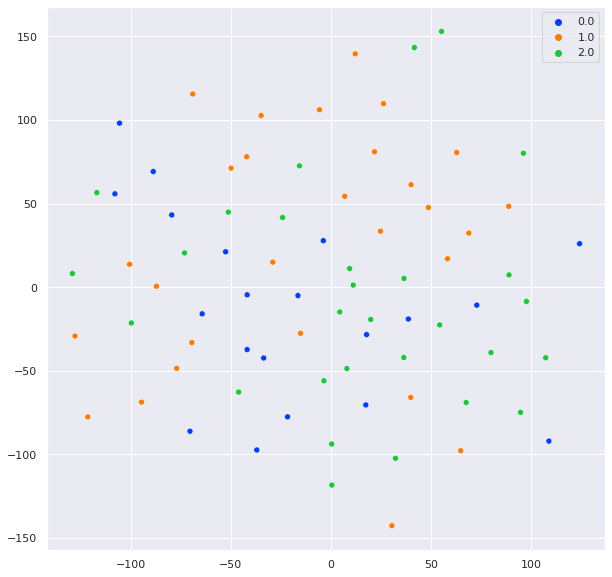

In [19]:
from sklearn.manifold import TSNE
import seaborn as sns

sns.set(rc={'figure.figsize':(10,10)})
tsne_em = TSNE(n_components=2, perplexity=30.0, n_iter=1000, verbose=1).fit_transform(training_data)

palette = sns.color_palette("bright", 3)
sns.scatterplot(tsne_em[:,0], tsne_em[:,1], hue=training_labels, legend='full', palette=palette)

### 1.1.2. Discussion
The SIFT feature extraction seems to be working properly, judging by the how the brute-force matcher performed. The t-SNE plot, however, does not act as expected. We expected a point-cloud containing 3 more distinct clusters. Instead we see 1 big cluster. This could also be the result of the fact that class 0 are imposter which are harder to tell from the other classes.

## 1.2. Baseline 2: PCA feature extractor

In [20]:
import sklearn.decomposition as decmp

# A baseline extractor whould look like this but we will use the sklean class directly
'''class PCAFeatureExtractor:
    def __init__(self, components):
        self.pca = decmp.PCA(n_components=components, svd_solver='randomized', whiten = True)
    
    def fit(self, X):
        X_flat = [img.flatten() for img in X]
        self.pca.fit(X_flat)
    
    def transform(self, X):
        X_flat = [img.flatten() for img in X]
        return self.pca.transform(X_flat)'''

"class PCAFeatureExtractor:\n    def __init__(self, components):\n        self.pca = decmp.PCA(n_components=components, svd_solver='randomized', whiten = True)\n    \n    def fit(self, X):\n        X_flat = [img.flatten() for img in X]\n        self.pca.fit(X_flat)\n    \n    def transform(self, X):\n        X_flat = [img.flatten() for img in X]\n        return self.pca.transform(X_flat)"

### 1.2.1. Eigenface Plots

To start the Principal component analysis, we have to transform the images to grayscale. We expect the shape to have a 3 in the end when we print the shape for 
the first time, denoting the extra dimension for the 3 color channels. After grayscaling, that dimension should dissappear.

Shape initially: (80, 100, 100, 3)
Shape after grayscaling: (80, 100, 100)
Dataset after grayscaling looks like this:


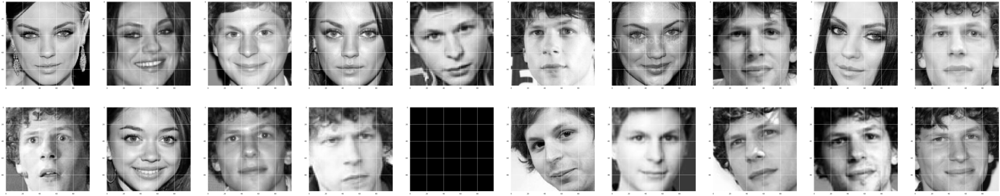

In [21]:
print(f"Shape initially: {train_X.shape}")
gray_train_X = np.array(array2gray(train_X))
print(f"Shape after grayscaling: {gray_train_X.shape}") # check if we effectively got rid of the extra dimensions
print("Dataset after grayscaling looks like this:")
plot_image_sequence(gray_train_X, n=20, imgs_per_row=10)

We will plot the variance to find out a good number of components to use


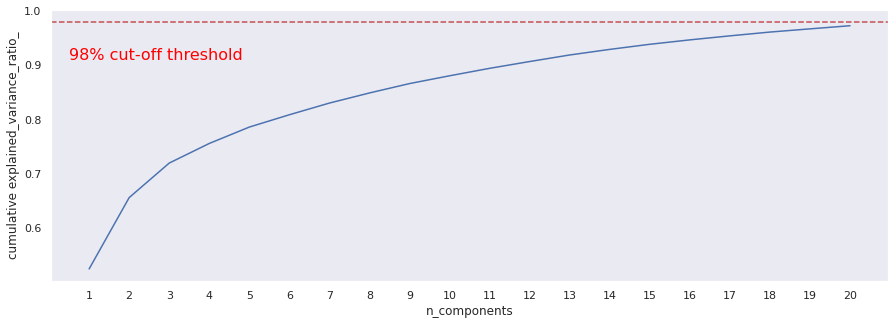

In [22]:
width, height = FACE_SIZE
components = 20
pca = decmp.PCA(n_components=components, svd_solver='randomized')
jesse_gray = gray_train_X[train_y == 1]
n_jesse_img = jesse_gray.shape[0]

flat_gray_jesse_train = [img.flatten() for img in jesse_gray]
jesse_train_pca = pca.fit_transform(flat_gray_jesse_train)

# decide what component number to put 
print("We will plot the variance to find out a good number of components to use")
fig, ax = plt.subplots(figsize=(15,5))
plt.xlabel('n_components')
plt.xticks(np.arange(1, 21, 1))
plt.ylabel('cumulative explained_variance_ratio_')
plt.grid()
plt.axhline(y=0.98, color='r', linestyle='--')
plt.text(0.5, 0.91, '98% cut-off threshold', color = 'red', fontsize=16)
ax.plot(range(1,21), pca.explained_variance_ratio_.cumsum())

20 seems a good number to pick as we barely lose any information.

We will now pick the images of Jesse to showcase how face reconstruction works. First we will get the eigenfaces of jesse and then attempt to 
recreate all the images based on these eigenfaces.

Eigenfaces of Jesse:


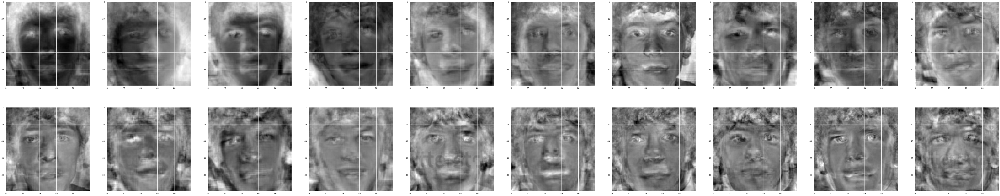

In [23]:
pca_comps = pca.components_.reshape(components, width, height)
print("Eigenfaces of Jesse:")
plot_image_sequence(pca_comps, n=components, imgs_per_row=10)

Reconstruction is based on the notions of "mean face" and "standard deviation face". Although we will not calculate them ourselves because they are already 
calculated for us by the PCA class, we will plot the mean face to gain some intuition.

Mean face of Jesse:


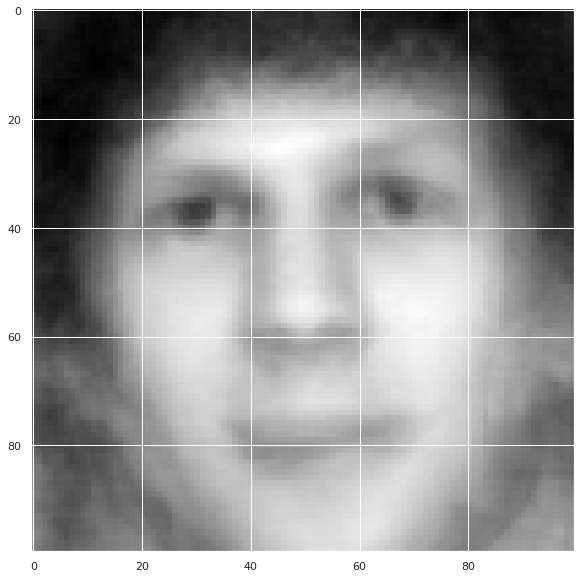

In [24]:
mean_jesse_face = pca.mean_.reshape(width, height)
print("Mean face of Jesse:")
plt.imshow(mean_jesse_face, cmap='gray')

#### Reconstructing faces
We will attempt to reconstruct the face of jesse using the all the components

Reconstructed images of Jesse:


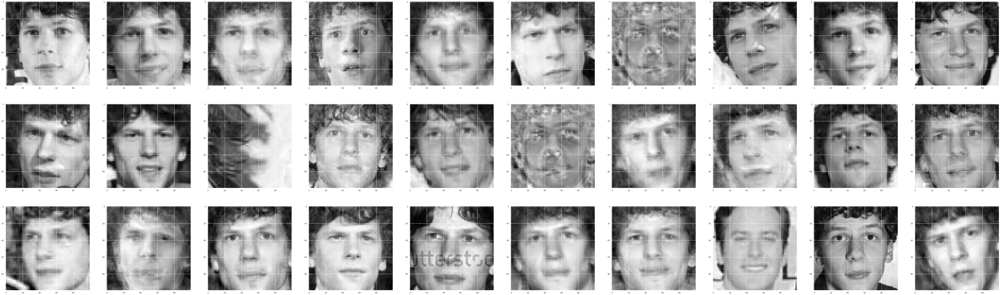

In [25]:
# reconst_face = mean_face + sd_face*reconst_face
reconstruct = pca.inverse_transform(jesse_train_pca).reshape(n_jesse_img, width, height)
print("Reconstructed images of Jesse:")
plot_image_sequence(reconstruct, n_jesse_img, 10)

### Gradual reconstruction of one face

To show the difference the number of eigenfaces makes, we will attempt to reconstruct one of Jesse's faces with a different number of eigenfaces

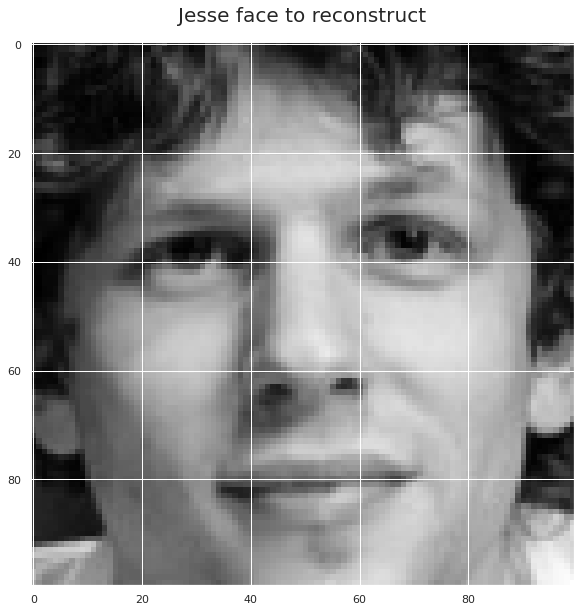

In [26]:
face_idx = 1
jesse_face = jesse_gray[face_idx] # pick a random face
plt.title("Jesse face to reconstruct", size=20, pad=20)
plt.imshow(jesse_face, cmap='gray')
#flat_jesse_face = jesse_face.flatten().reshape(1, -1) # reshape because it is a single sample
#print(flat_jesse_face)

Face reconstruction for various numbers of eigenfaces


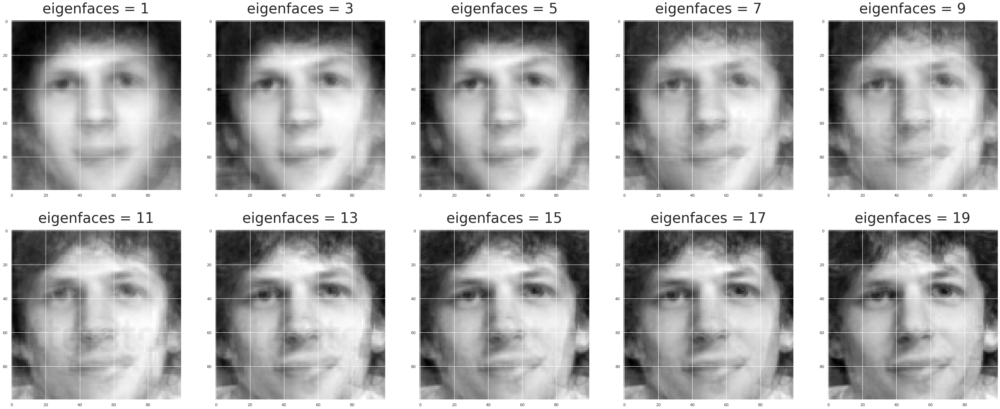

In [27]:
results = []
titles = []
for i in range(1, components, 2):
    temp_pca = decmp.PCA(n_components=i, svd_solver='randomized')
    temp_train_pca = temp_pca.fit_transform(flat_gray_jesse_train)
    reconstruct = temp_pca.inverse_transform(temp_train_pca).reshape(n_jesse_img, width, height)
    results.append(reconstruct[face_idx])
    titles.append((f'eigenfaces = {i}', 40, 20))


print("Face reconstruction for various numbers of eigenfaces")
plot_image_sequence(results, len(results), 5, titles=titles)
    

### 1.2.2. Feature Space Plots

Text(0, 0.5, 'PCA Component 2')

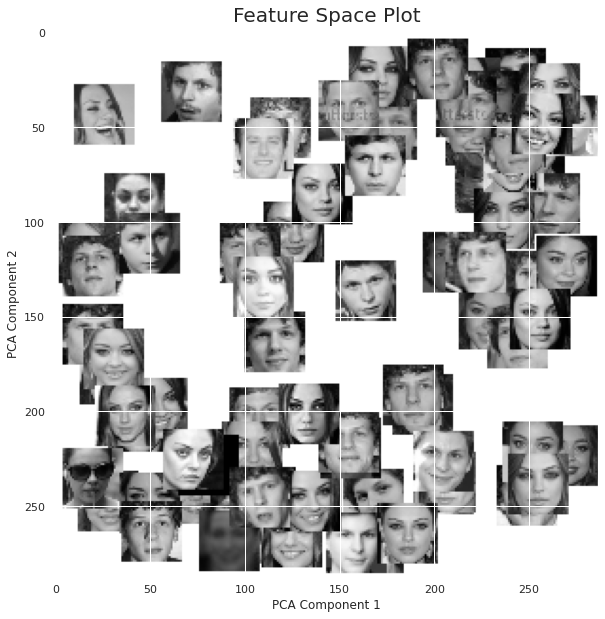

In [28]:
# By making these h, w shorter, we can more clearly see differences between points
proj_img_h, proj_img_w = 32, 32
n_components = 2

train_X_gray = array2gray(train_X)
flat_train_X_gray = [img.flatten() for img in train_X_gray]

pca_2_comps = decmp.PCA(n_components=n_components, svd_solver='randomized')
pca_2_comps.fit(flat_train_X_gray)
transform_X = pca_2_comps.transform(flat_train_X_gray)

# Normalizing values so that they are positive
transform_X_norm = np.array( [(x).astype('int8')+128 for x in transform_X ] )
norm_max = max( [ max(comp for comp in x) for x in transform_X_norm ] )

figure_img_h, figure_img_w = norm_max + proj_img_h, norm_max + proj_img_w
img = np.zeros([figure_img_h, figure_img_w], dtype=np.uint8)

img.fill(255)
img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
for i in range( len(train_X) ):
    curr_img = train_X_gray[i]
    curr_img = cv2.resize(curr_img,(proj_img_h, proj_img_w))
    curr_img = cv2.cvtColor(curr_img, cv2.COLOR_GRAY2RGB)
    x = transform_X_norm[i][0]
    y = transform_X_norm[i][1]
    img[y:y+proj_img_h, x:x+proj_img_w] = curr_img

plt.figure(figsize=(10,10))
plt.imshow(img)
plt.title('Feature Space Plot', size=20, pad=10)
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')

### 1.2.3 Discussion

We see that PCA is a powerful method to reduce dimensionality of the data. 
With our experiments, we saw that 20 eigenfaces produce a good result based on both the mathematical measuring of information loss and the visual result.
Using 20 eigenfaces, we got almost perfefct reconstructions of Jesse's faces. 

The preprocessing steps required to apply PCA on our dataset is grayscaling and then flattening the images.
After that, the PCA can transform the data.

We expect PCA to perform better than SIFT (or HOG) since both of them are somwhat outdated

# 2. Evaluation Metrics
## 2.0. Example: Accuracy
As example metric we take the accuracy. Informally, accuracy is the proportion of correct predictions over the total amount of predictions. It is used a lot in classification but it certainly has its disadvantages...

In [29]:
from sklearn.metrics import accuracy_score

# Will return the fraction of correctly classified examples.
def accuracyScore(trueLabels, predLabels):
    return accuracy_score(trueLabels, predLabels)

The closer accuracy is to 1, the better the predicted labels are. However, accuracy only works well if there are an equal number of samples belonging to each class. When the samples are skewed to a certain class, we could have a simple model always predicting this specific class. This way, the accuracy will be incredibly high, but it doesn't actually predict much. Especially when the cost of misclassifications is high, this can be a real problem.

## 2.1. Logarithmic Loss

Instead one can use Logarithmic Loss. This works well for binary classification, although it is possible to use it for multi-class. It takes the uncertainty of a prediction into account. Instead of using actual predicted classes, it uses the log of the probability of a classfor a specific sample together with the predicted labels to compute a loss. This wil also punish high probabilities for wrong values.

LogLoss = (&Sigma;<sub>1:N</sub>&Sigma;<sub>1:M</sub> (y<sub>ij</sub> log(p<sub>ij</sub>))) / N <br/>
where y<sub>ij</sub> indicates whether the sample i belongs to class j, p<sub>ij</sub> the probability of sample i belonging to class j, N the amount of samples and M the amount of classes.

Instead of maximising this score, a log loss closer to 0 indicates a better prediction and thus we want to minimise this score.

In [30]:
from sklearn.metrics import log_loss


# These predictions have to be in a format [[p11, p12, p13, ...], [p21, p22, p23, ...], ...] 
#   with p11 the chance of the first sample being of the first class, etc. in alphabetical order.
# This format can be achieved using predict_proba dependent on the type of classifier used: 
#   https://scikit-learn.org/stable/search.html?q=predict_proba
def logLoss(trueLabels, probLabels):
    return log_loss(trueLabels, probLabels)

However, this loss function is still susceptible to imbalanced datasets.

## 2.2. F1 Score

The F1 Score uses precision and recall to compute a score which is better the greater it is.

F1 = 2 * 1 / ( 1/recall + 1/precision )

Recall = The number of correctly labeled positives divided by all actually positive data. This is a synonym for TPR. <br />
Precision = The number of correctly labeled positives divided by all labeled positives.

If we were to just use recall or precision alone, we would have almost the same problem as with accuracy. Just predict all examples as true to get a 1 for our recall. Using only precision would leave a very precise model, but might lead to overfitting. The F1 score aims to maintain a balance between the two.

In [31]:
from sklearn.metrics import fbeta_score

# This one goes back to using acutally predicted labels, instead of probabilities
def f1Score(trueLabels, predLabels, weight = 1):
    return fbeta_score(trueLabels, predLabels, beta = weight, average='micro')

Precision and recall might however not have the same weight. In this case we might want to include domain knowledge. A weight, 0 -> +inf, can then be added to manage the tradeoff. The higher this weight, the more importance goes to recall with 1 being the middleground.

##  2.3. Area Under the Curve (AUC)

AUC is a evaluation metric for binary classification problems. As the name suggests, it measures the area under a curve: the Receiver Operating Characteric or ROC curve. 

This curve plots the True Positive Rate (y-axis) onto the False Positive Rate (x-axis). The TPR is the amount of True positives divided by the total amount of actual positives, whereas the FPR are the amount of falsely labeled positives with respect to all negative points. 

As both of these variables lie between 0 and 1, the maximum AUC is 1. The greater the AUC, the better the performance of the model.

In [32]:
from sklearn.metrics import roc_auc_score

# Uses the same probabilities as Logarithmic Loss.
def auc(trueLabels, probLabels):
    return roc_auc_score(trueLabels, probLabels)
    

As opposed to the F1 score or accuracy, AUC is independent from the threshold chosen.

# 3. Classifiers
## 3.0. Example: The *'not so smart'* classifier
This random classifier is not very complicated. It makes predictions at random, based on the distribution obseved in the training set. **It thus assumes** that the class labels of the test set will be distributed similarly to the training set.

In [33]:
class RandomClassificationModel:
    """Random classifier, draws a random sample based on class distribution observed 
    during training."""
    
    def fit(self, X, y):
        """Adjusts the class ratio instance variable to the one observed in y. 

        Parameters
        ----------
        X : tensor
            Training set
        y : array
            Training set labels

        Returns
        -------
        self : RandomClassificationModel
        """
        
        self.classes, self.class_ratio = np.unique(y, return_counts=True)
        self.class_ratio = self.class_ratio / self.class_ratio.sum()
        return self
        
    def predict(self, X):
        """Samples labels for the input data. 

        Parameters
        ----------
        X : tensor
            dataset
            
        Returns
        -------
        y_star : array
            'Predicted' labels
        """

        np.random.seed(0)
        return np.random.choice(self.classes, size = X.shape[0], p=self.class_ratio)
    
    def __call__(self, X):
        return self.predict(X)    

## 3.1. Baseline 1: My favorite classifier
...

In [34]:
class SVMClassifier:
    """TODO: this classifier is under construction."""
    
    def __init__(self, nkeypoints):
        self.recognizer = SVC(C=1.0, kernel="linear", probability=True)
        self.nkeypoints = nkeypoints
    def fit(self, X, y):
        self.recognizer.fit(X, y)
        
    def predict(self, X):
        vector_size = 128 * self.nkeypoints
        kp1, des1 = SIFT.sift.detectAndCompute(X, None)
        if des1 is None:
            return 1, [[0.01, 0.00, 0.00]]
        
        if len(kp1) < self.nkeypoints:
            # and duplicate some points if necessary
            current_len = len(kp1)
            vectors_needed = self.nkeypoints - current_len
            repeated_vectors = des1[0:vectors_needed, :]
            # concatenate repeats onto des1
            while len(des1) < self.nkeypoints:
                des1 = np.concatenate((des1, repeated_vectors), axis=0)
            # duplicate data just so we can run the model.
            des1[current_len:self.nkeypoints, :] = des1[0:vectors_needed, :]
        np.random.shuffle(des1)
        des1 = des1[0:self.nkeypoints, :]   # trim vector so all are same size
        data = des1.reshape(1, vector_size)
        
        prediction = self.recognizer.predict(data)
        probability = self.recognizer.predict_proba(data)
        return int(prediction[0]), probability

## 3.2. Baseline 2: Logistic Regression

In [35]:
from sklearn.linear_model import LogisticRegression

class LogRegClassifier: 
    def __init__(self):
        self.recogniser = LogisticRegression(solver='liblinear')
        
    def fit(self, X, y):
        self.recogniser.fit(X, y)
        
    def predict(self, X):
        predictions = self.recogniser.predict(X)
        probs = self.recogniser.predict_proba(X)
        return predictions, probs
        

## 3.3. Baseline 3: Multi_layer Perceptron

# 4. Experiments
<div class="alert alert-block alert-info"> <b>NOTE:</b> Do <i>NOT</i> use this section to keep track of every little change you make in your code! Instead, highlight the most important findings and the major (best) pipelines that you've discovered.  
</div>
<br>

## 4.0. Example: basic pipeline
The basic pipeline takes any input and samples a label based on the class label distribution of the training set. As expected the performance is very poor, predicting approximately 1/4 correctly on the training set. There is a lot of room for improvement but this is left to you ;). 

In [36]:
feature_extractor = IdentityFeatureExtractor() 
classifier = RandomClassificationModel()

# train the model on the features
classifier.fit(feature_extractor(train_X), train_y)

# model/final pipeline
model = lambda X: classifier(feature_extractor(X))

In [37]:
# evaluate performance of the model on the training set
train_y_star = model(train_X)

"The performance on the training set is {:.2f}. This however, does not tell us much about the actual performance (generalisability).".format(
    accuracy_score(train_y, train_y_star))

'The performance on the training set is 0.26. This however, does not tell us much about the actual performance (generalisability).'

In [38]:
# predict the labels for the test set 
test_y_star = model(test_X)

## 4.1. SVM classifier - SIFT features
 

In [39]:
from sklearn.preprocessing import LabelEncoder
from sklearn.svm import SVC
nkeypoints = 100
labels_test = [1,0,0,0,1,1,0,0,1,2,
               2,1,2,0,0,0,1,0,2,1,
               2,2,2,1,0,1,0,0,0,2,
               2,0,0,0,0,0,1,0,0,1,
               0,0,1,1,2,1,1,0,0,0,
               0,0,0,0,2,0,2,0,0,1,
               2,0,0,2,0,0,0,0,1,0,
               0,0,0,0,0,1,0,2,1,0,
               0,0,2,0,0,2,0,0,0,2,
               0,0,0,0,2,0,0,0,1,2]

SIFT = SIFTFeatureExtractor() 
classifier = SVMClassifier(nkeypoints)

# train the model on the features
test_gray = array2gray(test_X)

kp_list, training_data, training_labels = SIFT.transform_train(train_gray, train_y, nkeypoints)
training_labels = training_labels.reshape(training_labels.shape[0],)
classifier.fit(training_data, training_labels)

#test the model
pred_list = []
for img in test_gray:
    pred, prob = classifier.predict(img)
    pred_list.append(pred)
    
acc = accuracyScore(labels_test, pred_list[:100])
f1 = f1Score(labels_test, pred_list[:100])
print("Set accuracy = " + str(acc))
print("Set f1-score = " + str(f1))

# model/final pipeline
#model = lambda X: classifier(feature_extractor(X))

KeyboardInterrupt: 

## 4.2.1 Logistic Regression - SIFT features

In [40]:
def siftTransform(nkeypoints, images):
    SIFT = cv2.xfeatures2d.SIFT_create(nkeypoints)
    listX = []
    for img in images:
        kp, X = SIFT.detectAndCompute(img, None)  
        if X is None:
            X = np.zeros((nkeypoints, 128))
        if (len(X) < nkeypoints):
            empties = np.zeros((nkeypoints - len(X), 128))
            X = np.r_[X, empties]
        elif (len(X) > nkeypoints):
            X = X[:nkeypoints,]
        X = X.flatten()
        listX.append(X)
    return listX

## Actual pipeline starts here ##

classifier = LogRegClassifier()
nkeypoints = 25

train_gray = array2gray(train_X)
train_shift = siftTransform(nkeypoints, train_gray)    
classifier.fit(train_shift, train_y)

test_gray = array2gray(test_X)

test_shift = siftTransform(nkeypoints, test_gray)
pred_list, _ = classifier.predict(test_shift)

acc = accuracyScore(labels_test, pred_list[:100])
f1 = f1Score(labels_test, pred_list[:100])
print("Set accuracy = " + str(acc))
print("Set f1-score = " + str(f1))

Set accuracy = 0.38
Set f1-score = 0.38


## 4.2.2 Logistic Regression - PCA features

In [41]:
classifier = LogRegClassifier()
train_gray = array2gray(train_X)

components = 20
pca = decmp.PCA(n_components=components, svd_solver='randomized')
flat_gray_train = [img.flatten() for img in train_gray]
train_pca = pca.fit_transform(flat_gray_train)
train_reconstruct = pca.inverse_transform(train_pca).reshape(len(train_pca), 100, 100)
train_reconstruct_flat = np.array([img.flatten() for img in train_reconstruct])

classifier.fit(train_reconstruct_flat, train_y)
flat_gray_test = [img.flatten() for img in test_gray]
test_pca = pca.transform(flat_gray_test)

test_reconstruct = pca.inverse_transform(test_pca).reshape(len(test_pca), 100, 100)

test_reconstruct_flat = [img.flatten() for img in test_reconstruct]
pred, _ = classifier.predict(test_reconstruct_flat)

acc = accuracyScore(labels_test, pred[:100])
f1 = f1Score(labels_test, pred[:100])
print("Set accuracy = " + str(acc))
print("Set f1-score = " + str(f1))

Set accuracy = 0.57
Set f1-score = 0.57


## 4.3.1 Multi Layer Perceptron - SIFT features

In [42]:
from sklearn.neural_network import MLPClassifier

SIFT = SIFTFeatureExtractor() 
classifier = MLPClassifier()
nkeypoints = 85

# train the model on the features
train_gray = array2gray(train_X)

kp_list, training_data, training_labels = SIFT.transform_train(train_gray, train_y, nkeypoints)
classifier.fit(training_data, training_labels)

pred_list = []
for img in test_gray:
    kp1, X = SIFT.sift.detectAndCompute(img, None)
    if not X is None:
        vector_size = 128 * nkeypoints
        des = np.zeros((nkeypoints, 128), dtype=float)
        des[0:len(X)] = X[0:nkeypoints, :] 

        data = des.reshape(1, vector_size)
        pred = classifier.predict(data)
        pred_int = pred.astype(int)
        pred_int_ = pred_int[0]
    else:
        pred, probs = 0, [[0.01, 0.00, 0.00]]
    pred_list.append(pred_int_)

acc = accuracyScore(labels_test, pred_list[:100])
f1 = f1Score(labels_test, pred_list[:100])
print("set accuracy = " + str(acc))
print("set f1-score = " + str(f1))

set accuracy = 0.4
set f1-score = 0.4000000000000001


## 4.3.2 Multi Layer Perceptron - PCA features

In [43]:
from sklearn.neural_network import MLPClassifier

classifier = MLPClassifier()
train_gray = array2gray(train_X)

components = 20
pca = decmp.PCA(n_components=components, svd_solver='randomized')
flat_gray_train = [img.flatten() for img in train_gray]
train_pca = pca.fit_transform(flat_gray_train)
train_reconstruct = pca.inverse_transform(train_pca).reshape(len(train_pca), 100, 100)
train_reconstruct_flat = np.array([img.flatten() for img in train_reconstruct])

classifier.fit(train_reconstruct_flat, train_y)
flat_gray_test = [img.flatten() for img in test_gray]
test_pca = pca.transform(flat_gray_test)

test_reconstruct = pca.inverse_transform(test_pca).reshape(len(test_pca), 100, 100)

test_reconstruct_flat = [img.flatten() for img in test_reconstruct]
pred = classifier.predict(test_reconstruct_flat)

acc = accuracyScore(labels_test, pred[:100])
f1 = f1Score(labels_test, pred[:100])
print("Set accuracy = " + str(acc))
print("Set f1-score = " + str(f1))

Set accuracy = 0.5
Set f1-score = 0.5


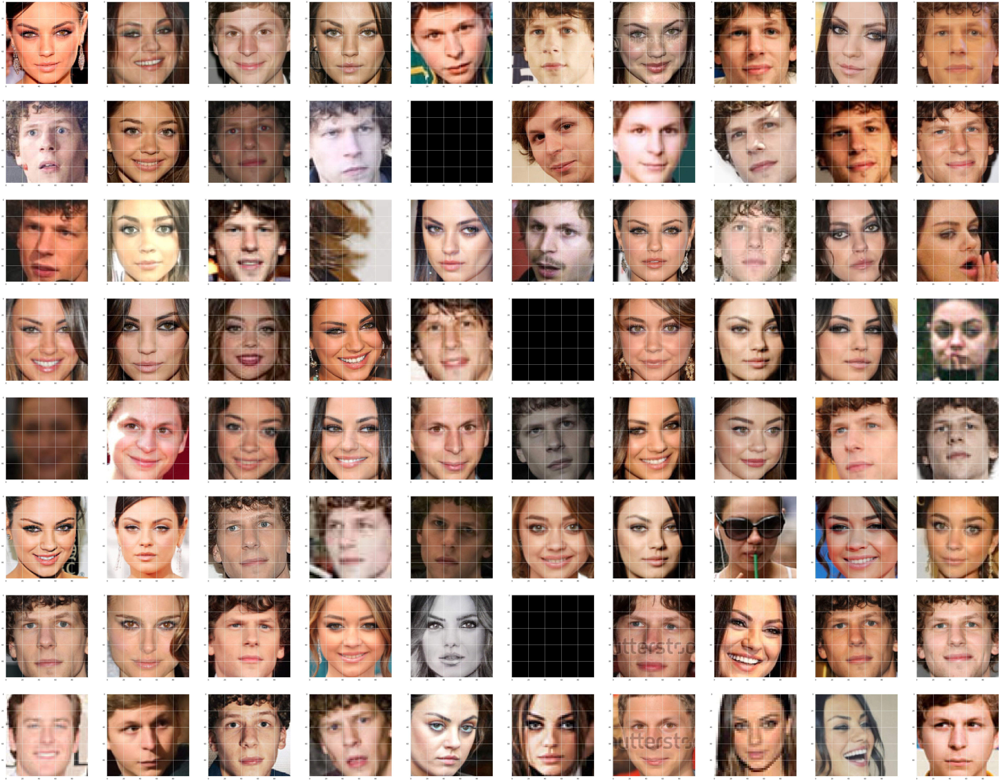

In [44]:
# manual labels for the first 100 images of the test dataset
plot_image_sequence(train_X, n=80, imgs_per_row=10)
# labels_test = [1,0,0,0,1,1,0,0,1,2,
#                2,1,2,0,0,0,1,0,2,1,
#                2,2,2,1,0,1,0,0,0,2,
#                2,0,0,0,0,0,1,0,0,1,
#                0,0,1,1,2,1,1,0,0,0,
#                0,0,0,0,2,0,2,0,0,1,
#                2,0,0,2,0,0,0,0,1,0,
#                0,0,0,0,0,1,0,2,1,0,
#                0,0,2,0,0,2,0,0,0,2,
#                0,0,0,0,2,0,0,0,1,2]

# 5. Publishing best results

In [45]:
submission = test.copy().drop('img', axis = 1)
submission['class'] = pred1
print(pred1)

NameError: name 'pred1' is not defined

In [ ]:
submission.to_csv('submission.csv')

# 6. Improve Performance

To further improve our prediction performance, we tried training a convolutional neural network using the tensorflow keras API. After converting our training set to grayscale, we then attempt to perform data augmentation (as our training set appears to be limited in size) by rotating and applying a horizontal flip to random images. After the convolutional layers of our network, we tried to incorporate dropout layers in between dense layers so as to avoid overfitting, but we did not notice any increase in accuracy. For our optimizer we chose 'Adam' and for our loss function we chose 'SparseCategoricalCrossentropy'.  

In [47]:
# !pip install tensorflow
import tensorflow as tf
import random

img_width, img_height = FACE_SIZE
num_classes = 3

training_data = np.array( array2gray(train_X) )
training_data = training_data.reshape(training_data.shape + (1,)) 

# Trying Data augmentation
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rotation_range=0.1,
#         width_shift_range=0.2,
#         height_shift_range=0.2,
#         zoom_range=0.1,
    horizontal_flip=True)
train_generator = train_datagen.flow(training_data, train_y)

model = tf.keras.Sequential([
    tf.keras.layers.experimental.preprocessing.Rescaling(1./255, input_shape=(img_height, img_width, 1)),
    tf.keras.layers.Conv2D(16, 3, padding='same', activation='relu'),
    tf.keras.layers.MaxPooling2D(),
    tf.keras.layers.Conv2D(32, 3, padding='same', activation='relu'),
    tf.keras.layers.MaxPooling2D(),
    tf.keras.layers.Conv2D(64, 3, padding='same', activation='relu'),
    tf.keras.layers.MaxPooling2D(),
    tf.keras.layers.Conv2D(128, 3, padding='same', activation='relu'),
    tf.keras.layers.MaxPooling2D(),
    tf.keras.layers.Conv2D(256, 3, padding='same', activation='relu'),
    tf.keras.layers.MaxPooling2D(),
    tf.keras.layers.Conv2D(512, 3, padding='same', activation='relu'),
    tf.keras.layers.MaxPooling2D(),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(1024, activation='relu'),
#   tf.keras.layers.Dropout(0.4),
    tf.keras.layers.Dense(512, activation='relu'),
#   tf.keras.layers.Dropout(0.4),
    tf.keras.layers.Dense(256, activation='relu'),
#   tf.keras.layers.Dropout(0.4),
    tf.keras.layers.Dense(128, activation='relu'),
#   tf.keras.layers.Dropout(0.4),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(num_classes)
])

model.compile(optimizer='adam',
                loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
                metrics=['accuracy'])
model.fit(train_generator, epochs=150)

probability_model = tf.keras.Sequential([model, 
                                            tf.keras.layers.Softmax()])

test_data = np.array( array2gray(test_X) )
test_data = test_data.reshape(test_data.shape + (1,)) 
predictions = probability_model.predict(test_data)
pred_list = [np.argmax(p) for p in predictions]

acc = accuracyScore(labels_test, pred_list[:100])
f1 = f1Score(labels_test, pred_list[:100])

print("set accuracy = " + str(acc))
print("set f1-score = " + str(f1))

Epoch 1/150
3/3 [==============================] - 1s 359ms/step - loss: 1.0972 - accuracy: 0.3625
Epoch 2/150
3/3 [==============================] - 1s 237ms/step - loss: 1.0926 - accuracy: 0.4010
Epoch 3/150
3/3 [==============================] - 1s 222ms/step - loss: 1.0882 - accuracy: 0.3750
Epoch 4/150
3/3 [==============================] - 1s 232ms/step - loss: 1.0766 - accuracy: 0.3958
Epoch 5/150
3/3 [==============================] - 1s 207ms/step - loss: 1.0604 - accuracy: 0.3542
Epoch 6/150
3/3 [==============================] - 1s 206ms/step - loss: 1.0505 - accuracy: 0.3438
Epoch 7/150
3/3 [==============================] - 1s 274ms/step - loss: 1.0023 - accuracy: 0.3948
Epoch 8/150
3/3 [==============================] - 1s 201ms/step - loss: 0.9505 - accuracy: 0.6505
Epoch 9/150
3/3 [==============================] - 1s 259ms/step - loss: 0.9430 - accuracy: 0.6292
Epoch 10/150
3/3 [==============================] - 1s 204ms/step - loss: 0.8480 - accuracy: 0.6523
Epoch 11/

We then continue to use transfer learning to train our neural network. In particular, we chose 'EfficientNetB0' as our transfer model. After a similar preprocessing and data augmentation pipeline, we add dense layers on top of our transfer model. It is important to note that we 'freeze' the transfer model's layers, so as to only train the ones we appended on top of it. With a training configuration similar to the one above, we did not note any major increase in prediction accuracy.


In [46]:
import tensorflow as tf

img_width, img_height = FACE_SIZE
img_shape = (img_width, img_height, 3)
num_classes = 3

training_data = train_X
transfer_model = tf.keras.applications.efficientnet.EfficientNetB0(input_shape=img_shape, 
                    include_top = False, 
                    weights = 'imagenet')

for layer in transfer_model.layers:
    layer.trainable = False

train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255,
    rotation_range=0.1,
#         width_shift_range=0.2,
#         height_shift_range=0.2,
#         zoom_range=0.1,
    horizontal_flip=True)
train_generator = train_datagen.flow(train_X, train_y)

inputs = tf.keras.Input(shape=img_shape)
x = transfer_model(inputs)
x = tf.keras.layers.Flatten()(x)
x = tf.keras.layers.Dense(2048, activation='relu')(x)
# x = tf.keras.layers.Dropout(0.4)(x)
x = tf.keras.layers.Dense(1024, activation='relu')(x)
# x = tf.keras.layers.Dropout(0.4)(x)
x = tf.keras.layers.Dense(512, activation='relu')(x)
# x = tf.keras.layers.Dropout(0.4)(x)
x = tf.keras.layers.Dense(256, activation='relu')(x)
# x = tf.keras.layers.Dropout(0.4)(x)
x = tf.keras.layers.Dense(128, activation='relu')(x)
# x = tf.keras.layers.Dropout(0.4)(x)
x = tf.keras.layers.Dense(64, activation='relu')(x)
# x = tf.keras.layers.Dropout(0.4)(x)
outputs = tf.keras.layers.Dense(num_classes, activation="softmax")(x)

model = tf.keras.Model(inputs, outputs)
model.compile(
                optimizer='adam',
            #    optimizer=tf.keras.optimizers.RMSprop(lr=0.001, decay=1e-6),
                loss=tf.keras.losses.SparseCategoricalCrossentropy(),
                metrics=['accuracy'])
early_stop = tf.keras.callbacks.EarlyStopping(monitor='loss', min_delta=0, patience=20, verbose=0,
                                                restore_best_weights=True)

model.fit(train_generator, epochs=150, callbacks=[early_stop], verbose=1)

test_data = test_X
predictions = model.predict(test_data)
pred_list = [np.argmax(p) for p in predictions]

acc = accuracyScore(labels_test, pred_list[:100])
f1 = f1Score(labels_test, pred_list[:100])

print("set accuracy = " + str(acc))
print("set f1-score = " + str(f1))

Epoch 1/150
3/3 [==============================] - 8s 464ms/step - loss: 3.0181 - accuracy: 0.3443
Epoch 2/150
3/3 [==============================] - 2s 502ms/step - loss: 5.4895 - accuracy: 0.3336
Epoch 3/150
2/3 [===================>..........] - ETA: 0s - loss: 1.9487 - accuracy: 0.3906

KeyboardInterrupt: 

# 7. Discussion

We noticed that for classification, the PCA features seem to work better than SIFT features. This is expected since SIFT is an older, somewhat outdate technique. Our results on PCA were still not great, this may be due to the fact that we only posess 80 training samples, which might be too little to make use of PCA effectively.

A thing we could have done if we had more time is combining both feature extraction techniques. This could result in a more robust and accurate classifier.


In summary we contributed the following: 
* Manually corrected wrongly labeled training data
* Feature extraction using SIFT and PCA
* SVM classifier using SIFT
* Logistic Regression using SIFT and PCA separately
* Multi Layer Perceptron using SIFT and PCA separately
* CNN trained using the grayscale training images

The best result we obtained is using the CNN with a accuracy score of 0.71.
